This notebook contains plots for dissolved phase and particulate phase from 1968-2008.

In [1]:
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

In [2]:
import netCDF4 as nc
import matplotlib.pyplot as plt
import numpy as np
import copy
import os
import glob
import pylab as pl
import numpy as np
import matplotlib.animation as animation
import types
from mpl_toolkits.basemap import cm,addcyclic,Basemap, shiftgrid
import matplotlib.patches as patches
% matplotlib inline

In [3]:
nc_filename=sorted(glob.glob('/ocean/xiaoxiny/research/result_jasper/min_ice/nasaRun/Y*2008*.nc'))#*_ptrc_T*.nc'))
print("found *.nc file: \n{}".format(nc_filename))
ptrc=nc.Dataset(nc_filename[0])

uvel=nc.Dataset('/ocean/xiaoxiny/research/result_jasper/data_eng3/ANHA4-ENG3_gridU_19692008.nc')
print uvel.variables

vvel=nc.Dataset('/ocean/xiaoxiny/research/result_jasper/data_eng3/ANHA4-ENG3_gridV_19692008.nc')
print vvel.variables

wvel=nc.Dataset('/ocean/xiaoxiny/research/result_jasper/data_eng3/ANHA4-ENG3_gridW_19692008.nc')
print wvel.variables

found *.nc file: 
['/ocean/xiaoxiny/research/result_jasper/min_ice/nasaRun/Y19682008.nc']
OrderedDict([(u'nav_lon', <netCDF4.Variable object at 0x7f3ab9a56d60>), (u'nav_lat', <netCDF4.Variable object at 0x7f3ab9a56df8>), (u'depthu', <netCDF4.Variable object at 0x7f3ab9a56e90>), (u'time_counter', <netCDF4.Variable object at 0x7f3ab9a56f28>), (u'vozocrtx', <netCDF4.Variable object at 0x7f3ab8daf050>), (u'sozotaux', <netCDF4.Variable object at 0x7f3ab8daf0e8>)])
OrderedDict([(u'nav_lon', <netCDF4.Variable object at 0x7f3ab8daf218>), (u'nav_lat', <netCDF4.Variable object at 0x7f3ab8daf2b0>), (u'depthv', <netCDF4.Variable object at 0x7f3ab8daf348>), (u'time_counter', <netCDF4.Variable object at 0x7f3ab8daf3e0>), (u'vomecrty', <netCDF4.Variable object at 0x7f3ab8daf478>), (u'sometauy', <netCDF4.Variable object at 0x7f3ab8daf510>)])
OrderedDict([(u'nav_lon', <netCDF4.Variable object at 0x7f3ab8daf640>), (u'nav_lat', <netCDF4.Variable object at 0x7f3ab8daf6d8>), (u'depthw', <netCDF4.Variable o

In [4]:
lon=ptrc.variables['nav_lon'][:,:]
lat=ptrc.variables['nav_lat'][:,:]
dep = ptrc.variables['deptht'][:]


tmask=nc.Dataset(
        '/ocean/xiaoxiny/research/NEMO-code/NEMOGCM/CONFIG/myANHA/EXP00/crop.nc')
mbathy=tmask.variables['mbathy'][0,400:,:]
tmask=tmask.variables['tmask'][0,:,400:,:]


bathy=nc.Dataset(
    '/ocean/xiaoxiny/research/data/Jasper/ANHA4_bathy_etopo1_gebco1_smoothed_coast_corrected_mar10.nc')
bathy=bathy.variables['Bathymetry'][400:,:]

In [5]:
yearnum=len(ptrc.variables['TR_7'][:,0,0,0])

# 1. dissolved phase

(39,)
0
1
2
0
1
2


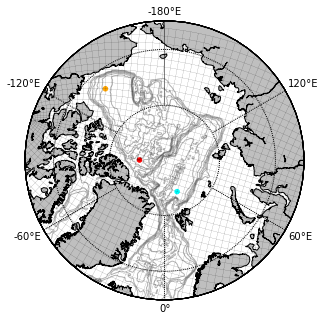

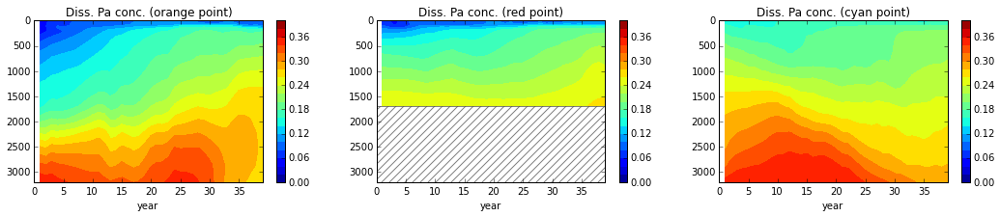

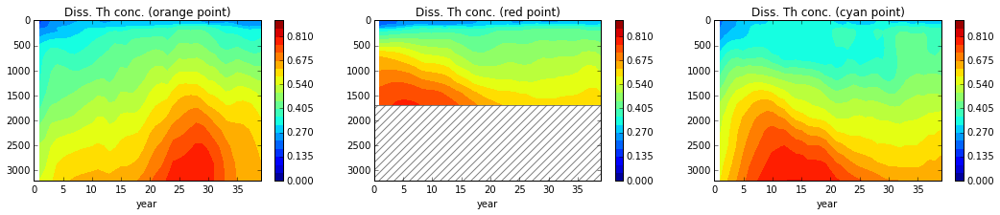

In [196]:
x=np.array([700-400,590-400,560-400])#/2
y=np.array([180,264,340])#/2
c=['orange','red','cyan']


time=np.empty(yearnum)
print time.shape
for i in range (len(time)):
    time[i]=i+1
    
    
fig = plt.figure(figsize=(5,10))
ax = fig.add_subplot()
m = Basemap(projection='npstere',boundinglat=65,lon_0=0,resolution='l',round='TRUE')
m.drawcoastlines()
m.fillcontinents(color = '0.75')
m.drawparallels(np.arange(-80.,80.,10.),labels=[1, 0, 0, 0])
m.drawmeridians(np.arange(-180.,180.,60.),labels=[0, 0, 1, 1])
x_lon,y_lat = m(lon,lat)
m.plot(x_lon[::10,::10],y_lat[::10,::10],x_lon.T[::10,::10],y_lat.T[::10,::10],color='k',linewidth=0.1)
m.scatter(x_lon[x,y],y_lat[x,y],color=c,s=20)
cs=m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.3)
#plt.clabel(cs, fontsize=10, inline=1,fmt = '%1.0f')


    
fig = plt.figure(figsize=(18,3))
for i in range (len(y)):
    print i
    ax = fig.add_subplot(1,3,i+1)
    data=ptrc.variables['TR_7'][:,10:,x[i],y[i]]
    data=np.ma.masked_where(data<=0,data)
    ax.add_patch(patches.Rectangle((0, dep[mbathy[x[i],y[i]]-1]), len(time),3000,hatch='///',
                                   fill=False,alpha=0.5))
    
    plt.contourf(time[:],dep[10:],data.T,np.linspace(0, 0.4, 21))
    plt.colorbar()
    plt.title('Diss. Pa conc. (%s point)'%c[i])
    plt.ylim(0,3200)
    plt.xlim(1,len(time))
    plt.xlabel('year')
    ax.invert_yaxis()
    plt.xticks(np.arange(0, len(time)+1, 5))

 
    
fig = plt.figure(figsize=(18,3))
for i in range (len(y)):
    print i
    ax = fig.add_subplot(1,3,i+1)
    data=ptrc.variables['TR_8'][:,10:,x[i],y[i]]
    data=np.ma.masked_where(data<=0,data)
    ax.add_patch(patches.Rectangle((0, dep[mbathy[x[i],y[i]]-1]), len(time),3000,hatch='///',
                                   fill=False,alpha=0.5))
    
    plt.contourf(time[:],dep[10:],data.T,np.linspace(0,0.9, 21))
    plt.colorbar()
    plt.title('Diss. Th conc. (%s point)'%c[i])
    plt.ylim(0,3200)
    plt.xlabel('year')
    ax.invert_yaxis() 
    plt.xticks(np.arange(0, len(time)+1, 5))

plt.show()

In [59]:
# find cross Canada profile (1)
c=['orange','red','cyan']
x=np.array([720-400])
y=np.array([160])
a_=np.zeros([190,1])
b_=np.zeros([190,1])

/home/xiaoxiny/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:73: RuntimeWarning: divide by zero encountered in divide


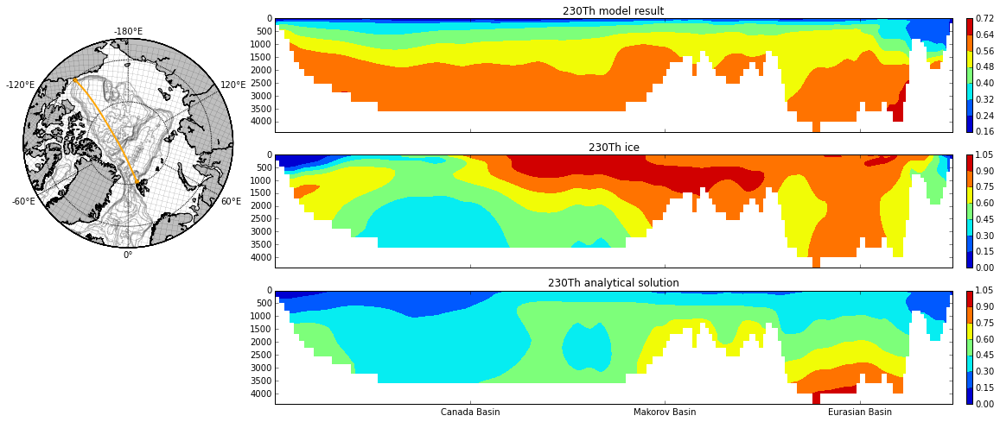

In [91]:
from matplotlib import gridspec

fig = plt.figure(figsize=(20,8))
gs = gridspec.GridSpec(3, 4)

# 1st plot
ax = fig.add_subplot(gs[0:2,0])

m = Basemap(projection='npstere',boundinglat=65,lon_0=0,resolution='l',round='TRUE')
m.drawcoastlines()
m.fillcontinents(color = '0.75')
m.drawparallels(np.arange(-80.,80.,10.),labels=[1, 0, 0, 0])
m.drawmeridians(np.arange(-180.,180.,60.),labels=[0, 0, 1, 1])
x_lon,y_lat = m(lon,lat)
m.plot(x_lon[::10,::10],y_lat[::10,::10],x_lon.T[::10,::10],y_lat.T[::10,::10],color='k',linewidth=0.1)
# find cross Canada profile (2)
for j in range (len (y)):
    a=[]
    b=[]
    for i in range (190):
        a.append(x_lon[x[j]-i,y[j]+i])
        b.append(y_lat[x[j]-i,y[j]+i])
    a_[:,j]=a
    b_[:,j]=b
    m.plot(a_[:,j],b_[:,j],color=c[j],linewidth=2)
m.scatter(a_[0],b_[0],color=c,s=20)
m.scatter(a_[-1],b_[-1],color=c,s=20)
m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.3)


#Model results
ax = fig.add_subplot(gs[0,1:4])
data_=np.zeros([50,190,len (y)])
for j in range (len (y)):
    for i in range (190):
        data_[:,i,j]=ptrc.variables['TR_8'][-1,:,x[j]-i,y[j]+i]
data_=np.ma.masked_where(data_<=0,data_)
plt.contourf(a_[:,j],dep[:-3],data_[:-3,:,0]);plt.colorbar(fraction=0.03,pad=0.02)
ax.invert_yaxis()
plt.xticks(np.arange(a_[:,0].min(), a_[:,0].max(),480000))
ax.get_xaxis().set_ticklabels([])
plt.title('230Th model result')


#Model results
ax = fig.add_subplot(gs[1,1:4])
data_=np.zeros([50,190,len (y)])
for j in range (len (y)):
    for i in range (190):
        data_[:,i,j]=ptrc.variables['TR_12'][-1,:,x[j]-i,y[j]+i]
data_=np.ma.masked_where(data_<=0,data_)
plt.contourf(a_[:,j],dep[:-3],data_[:-3,:,0]);plt.colorbar(fraction=0.03,pad=0.02)
ax.invert_yaxis()
plt.xticks(np.arange(a_[:,0].min(), a_[:,0].max(),480000))
ax.get_xaxis().set_ticklabels([])
plt.title('230Th ice')



#analy solution
ax = fig.add_subplot(gs[2,1:4])
data_=np.zeros([50,190,len (y)])
for j in range (len (y)):
    for i in range (190):
        data_[:,i,j]=ptrc.variables['TR_12'][-1,:,x[j]-i,y[j]+i]
data_=np.ma.masked_where(data_<=0,data_)
#analy
Q = 0.0267
k_de= 0.5
s = -1115*data_+1600
k_ad = -0.12*data_+0.2
for i in range (len(ptrc.variables['TR_12'][0,:,0,0])):
    data_[i,:,:] = Q/k_ad[i,:,:] + k_de/k_ad[i,:,:]*(Q/s[i]*dep[i])
    #
plt.contourf(a_[:,j],dep[:-3],data_[:-3,:,0]);plt.colorbar(fraction=0.03,pad=0.02)
ax.invert_yaxis()
#change label for the bottom plot
plt.xticks(np.arange(a_[:,0].min(), a_[:,0].max(),480000))
a=ax.get_xticks().tolist()
a[0]='';a[1]='Canada Basin';a[2]='Makorov Basin';a[3]='Eurasian Basin'
ax.set_xticklabels(a)
plt.title('230Th analytical solution')

plt.show()

/home/xiaoxiny/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:18: RuntimeWarning: divide by zero encountered in divide


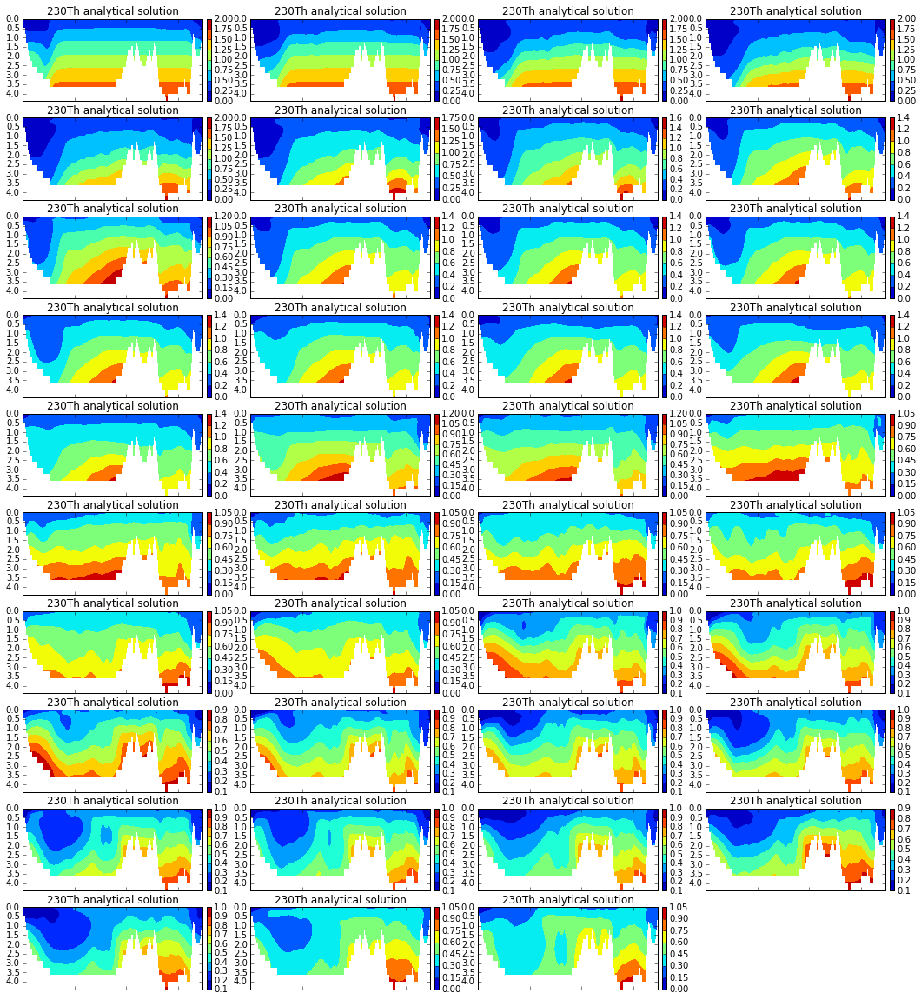

In [89]:
layer=38
k=0

fig = plt.figure(figsize=(18,20))
for k in range (0,yearnum,1):
    ax = fig.add_subplot(10,4,k+1)
    data_=np.zeros([50,190,len (y)])
    for j in range (len (y)):
        for i in range (190):
            data_[:,i,j]=ptrc.variables['TR_12'][k,:,x[j]-i,y[j]+i]
    data_=np.ma.masked_where(data_<=0,data_)
    #analy
    Q = 0.0267
    k_de= 0.5
    s = -1115*data_+1600
    k_ad = -0.12*data_+0.2
    for numdep in range(len(ptrc.variables['TR_12'][0,:,0,0])):
        data_[numdep,:,:] = Q/k_ad[numdep,:,:] + k_de/k_ad[numdep,:,:]*(Q/s[numdep,:,:]*dep[numdep])
        #
    cs=ax.contourf(a_[:,j],dep[:-3]/1000,data_[:-3,:,0]);
    plt.colorbar(cs,fraction=0.03,pad=0.02)
    ax.invert_yaxis()
    #change label for the bottom plot
    plt.xticks(np.arange(a_[:,0].min(), a_[:,0].max(),480000))
    ax.get_xaxis().set_ticklabels([])
    plt.title('230Th analytical solution')

plt.show()

# 1.1 diss Pa (test function) 

In [146]:
def vel(keyword,time):
    'design to obtain velocity field'
    if keyword =='U':
        data =uvel.variables['vozocrtx'][time,:,400:,:]
    elif keyword =='V':
        data =vvel.variables['vomecrty'][time,:,400:,:]
    else:
        data =wvel.variables['vovecrtz'][time,:,400:,:]
    data =np.ma.masked_where(tmask==0,data)
    return data

In [28]:
# calculate mean v,u
time=-1
layer=38
v =vel('V',time)
print 2.5*abs(v[layer,:,:]).mean()

u =vel('U',time)
print 2.5*abs(u[layer,:,:]).mean()

0.0259871087391
0.0203952841816


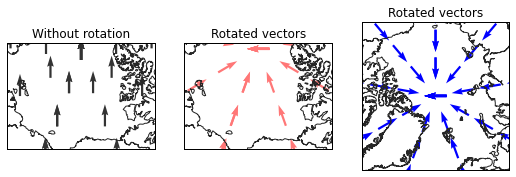

In [129]:
fig=plt.figure(figsize=(9, 3))


map = Basemap(width =3.5e6,height =2.5e6,lon_0=-160, lat_0=80,
            projection='stere', resolution='l')
lons = np.linspace(-180, 180, 10)
lats = np.linspace(60, 90,5)

lons, lats = np.meshgrid(lons, lats)

v10 = np.ones((lons.shape)) * 15
u10 = np.zeros((lons.shape))

u10_rot, v10_rot, x, y = map.rotate_vector(u10, v10, lons, lats, returnxy=True)

ax = fig.add_subplot(131)
ax.set_title('Without rotation')


map.drawcoastlines(color = '0.15')


map.quiver(x, y, u10, v10, 
    pivot='middle', color='#333333',scale=100,width=0.015)

ax = fig.add_subplot(132)
ax.set_title('Rotated vectors')


map.drawcoastlines(color = '0.15')

map.quiver(x, y, u10_rot, v10_rot, 
    pivot='middle', color='#ff7777',scale=100,width=0.015)


ax = fig.add_subplot(133)
map = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')


u10_rot, v10_rot, x, y = map.rotate_vector(u10, v10, lons, lats, returnxy=True)

ax.set_title('Rotated vectors')
map.drawcoastlines(color = '0.15')
map.quiver(x, y, u10_rot, v10_rot, 
    pivot='middle', color='blue',scale=100,width=0.015)


plt.show()


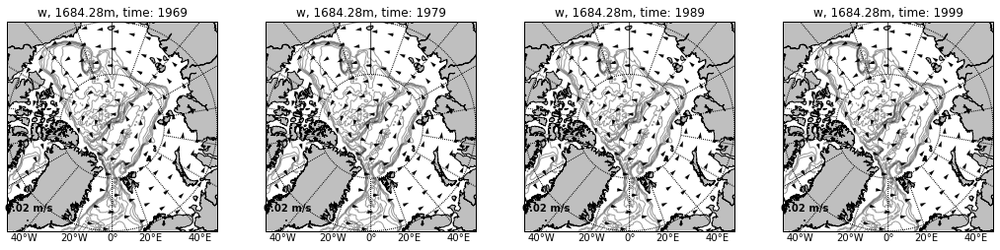

In [189]:
layer=38
k=0
lon=ptrc.variables['nav_lon'][:,:]
lat=ptrc.variables['nav_lat'][:,:]
fig = plt.figure(figsize=(18,45))
for i in range (0,yearnum,10):
    time =i
    k+=1

    ax = fig.add_subplot(10,4,k)
    m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    u =vel('U',time)
    v =vel('V',time)
    #mask too large value
    u =np.ma.masked_where(abs(v)>0.03,u)
    u[:] = 1
    v =np.ma.masked_where(abs(v)>0.03,v)
    v[:] = 0

    u, v, x_lon, y_lat = m.rotate_vector(u[layer,:,:], v[layer,:,:], lon, lat, returnxy=True)
    Q=m.quiver(x_lon[::25,::25], y_lat[::25,::25], u[::25,::25], v[::25,::25],
               width=0.01,pivot='middle')
    Qlabel=plt.quiverkey(Q,0.1, 0.05, 0.02, '0.02 m/s',fontproperties={'weight': 'bold'}) #x(0-1),y(0-1), scale, label, position

    m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    
    plt.title('w, %sm, time: %s'%(dep[layer],1969+i))

plt.show()

In [7]:
def vel(keyword,time):
    'design to obtain velocity field'
    if keyword =='U':
        data =uvel.variables['vozocrtx'][time,:,400:,:]
    elif keyword =='V':
        data =vvel.variables['vomecrty'][time,:,400:,:]
    else:
        data =wvel.variables['vovecrtz'][time,:,400:,:]
    #data =np.ma.masked_where(tmask==0,data)
    return data

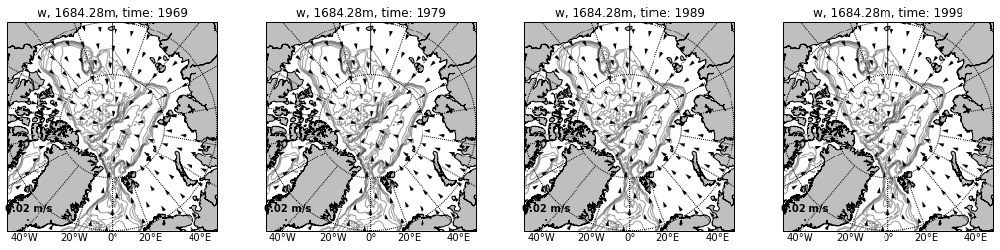

In [194]:
layer=38
k=0
lon=ptrc.variables['nav_lon'][:,:]
lat=ptrc.variables['nav_lat'][:,:]
fig = plt.figure(figsize=(18,45))
for i in range (0,yearnum,10):
    time =i
    k+=1

    ax = fig.add_subplot(10,4,k)
    m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    u =vel('U',time)
    v =vel('V',time)
    #mask too large value
    u =np.ma.masked_where(abs(v)>0.03,u)
    u[:] = 0
    v =np.ma.masked_where(abs(v)>0.03,v)
    v[:] = 1
    uu = np.zeros((u.shape))
    u  = u-uu

    u, v, x, y = m.rotate_vector(u[layer,:,:], v[layer,:,:], lon[:,:], lat[:,:], returnxy=True)
    Q=m.quiver(x[::25,::25], y[::25,::25], u[::25,::25], v[::25,::25],
               width=0.01,pivot='middle')
    Qlabel=plt.quiverkey(Q,0.1, 0.05, 0.02, '0.02 m/s',fontproperties={'weight': 'bold'}) #x(0-1),y(0-1), scale, label, position

    m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    
    plt.title('w, %sm, time: %s'%(dep[layer],1969+i))

plt.show()

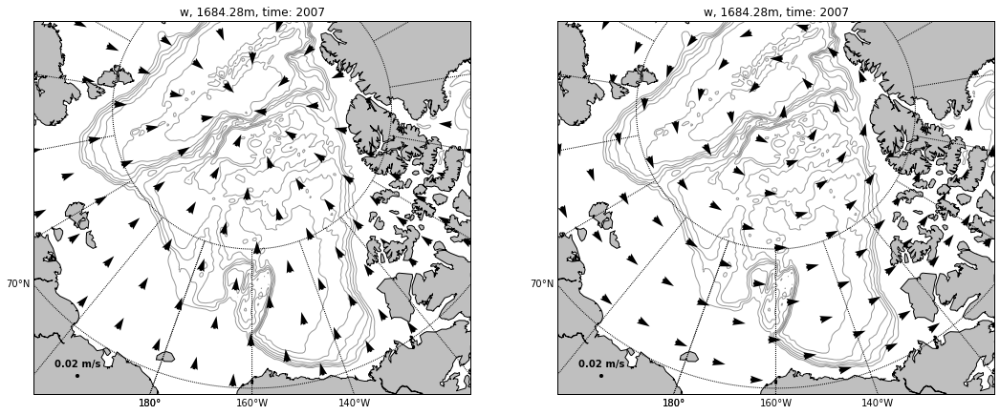

In [220]:
fig = plt.figure(figsize=(18,45))
for i in range (yearnum-1,yearnum):
    time =i
    k+=1

    ax = fig.add_subplot(121)
    m = Basemap(width =3.5e6,height =3e6,lon_0=-160, lat_0=83,
            projection='stere', resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    u =vel('U',time)
    v =vel('V',time)
    #mask too large value
    u =np.ma.masked_where(abs(v)>0.03,u)
    u[:] = 0
    v =np.ma.masked_where(abs(v)>0.03,v)
    v[:] = 1
    uu = np.zeros((u.shape))
    u  = u-uu

    u, v, x, y = m.rotate_vector(u[layer,:,:], v[layer,:,:], lon[:,:], lat[:,:], returnxy=True)
    Q=m.quiver(x[::25,::25], y[::25,::25], u[::25,::25], v[::25,::25],
               width=0.01,pivot='middle')
    Qlabel=plt.quiverkey(Q,0.1, 0.05, 0.02, '0.02 m/s',fontproperties={'weight': 'bold'}) #x(0-1),y(0-1), scale, label, position

    m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    
    plt.title('w, %sm, time: %s'%(dep[layer],1969+i))
    
    ax = fig.add_subplot(122)
    m = Basemap(width =3.5e6,height =3e6,lon_0=-160, lat_0=83,
            projection='stere', resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    u =vel('U',time)
    v =vel('V',time)
    #mask too large value
    u =np.ma.masked_where(abs(v)>0.03,u)
    u[:] = 1
    v =np.ma.masked_where(abs(v)>0.03,v)
    v[:] = 0
    uu = np.zeros((u.shape))
    u  = u-uu

    u, v, x, y = m.rotate_vector(u[layer,:,:], v[layer,:,:], lon[:,:], lat[:,:], returnxy=True)
    Q=m.quiver(x[::25,::25], y[::25,::25], u[::25,::25], v[::25,::25],
               width=0.01,pivot='middle')
    Qlabel=plt.quiverkey(Q,0.1, 0.05, 0.02, '0.02 m/s',fontproperties={'weight': 'bold'}) #x(0-1),y(0-1), scale, label, position

    m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    
    plt.title('w, %sm, time: %s'%(dep[layer],1969+i))

plt.show()

# before rotation (velocity field). 
 
 Just curious about whether there is any upwelling around the CB edge.. (It turns out that )

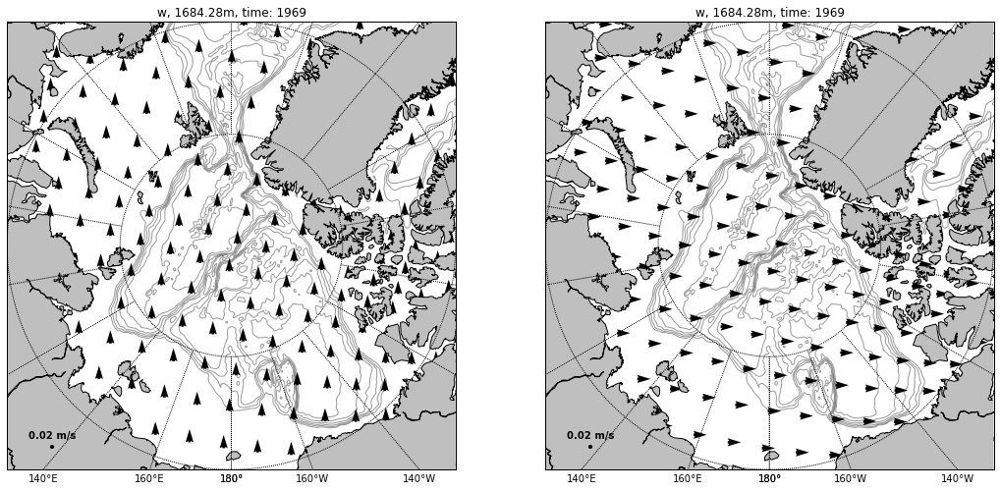

In [226]:
layer=38
k=0

fig = plt.figure(figsize=(18,45))
for i in range (0,1,10):
    time =i
    k+=1

    ax = fig.add_subplot(121)
    m = Basemap(projection='npstere',boundinglat=70,lon_0=-180,resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    u =vel('U',time)
    v =vel('V',time)
    #mask too large value
    u =np.ma.masked_where(abs(v)>0.03,u)
    u[:] = 0
    v =np.ma.masked_where(abs(v)>0.03,v)
    v[:] = 1
    uu = np.zeros((u.shape))
    u  = u-uu
    
    Q=m.quiver(x_lon[::25,::25], y_lat[::25,::25], u[layer,::25,::25], v[layer,::25,::25],
               width=0.01)
    Qlabel=plt.quiverkey(Q,0.1, 0.05, 0.02, '0.02 m/s',fontproperties={'weight': 'bold'}) #x(0-1),y(0-1), scale, label, position

    m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    
    plt.title('w, %sm, time: %s'%(dep[layer],1969+i))
    
    
    ax = fig.add_subplot(122)
    m = Basemap(projection='npstere',boundinglat=70,lon_0=-180,resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    u =vel('U',time)
    v =vel('V',time)
    #mask too large value
    u =np.ma.masked_where(abs(v)>0.03,u)
    u[:] = 1
    v =np.ma.masked_where(abs(v)>0.03,v)
    v[:] = 0
    uu = np.zeros((u.shape))
    u  = u-uu
    
    Q=m.quiver(x_lon[::25,::25], y_lat[::25,::25], u[layer,::25,::25], v[layer,::25,::25],
               width=0.01)
    Qlabel=plt.quiverkey(Q,0.1, 0.05, 0.02, '0.02 m/s',fontproperties={'weight': 'bold'}) #x(0-1),y(0-1), scale, label, position

    m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    
    plt.title('w, %sm, time: %s'%(dep[layer],1969+i))

plt.show()

In [34]:
w =vel('W',time)
print abs(w[layer,:,:]).mean()

2.67956991036e-05


In [37]:
print 'tracers can vertically travel about ',2.68e-05*3600*24*365,'m per year.' 

tracers can vertically travel about  845.1648 m per year.


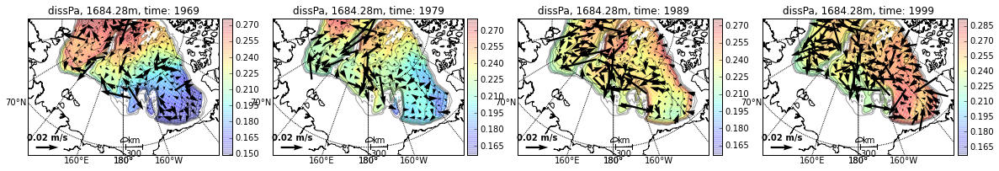

In [197]:
#test
layer=38
k=0

fig = plt.figure(figsize=(20,40))
for i in range (0,yearnum,10):
    time =i
    data =ptrc.variables['TR_7'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)

    k+=1

    ax = fig.add_subplot(10,4,k)
    m = Basemap(width =3.5e6,height =2.5e6,lon_0=-180, lat_0=80,
            projection='stere', resolution='l')
    m.drawcoastlines()
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[layer,:,:],alpha=0.1);m.colorbar()
    m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    #quiver
    U =vel('U',time)
    V =vel('V',time)
    #mask too large value
    u =np.ma.masked_where(abs(V)>0.03,U)
    v =np.ma.masked_where(abs(V)>0.03,V)
    u =np.ma.masked_where(abs(U)>0.03,u)
    v =np.ma.masked_where(abs(U)>0.03,v)
    uu = np.zeros((u.shape))
    vv = np.zeros((v.shape))
    u = u - uu
    v = v - vv
    
    u_rot, v_rot, x, y = m.rotate_vector(u[layer,::10,::10], v[layer,::10,::10], \
                                         lon[::10,::10], lat[::10,::10], returnxy=True)

    #Q=m.quiver(lon[::10,::10],lat[::10,::10], -u[layer,::10,::10], v[layer,::10,::10],
    #           scale=0.25,width=0.01,latlon=True)
    Q=m.quiver(x, y, u_rot, v_rot,
               scale=0.17,width=0.01,pivot='middle')
    Qlabel=plt.quiverkey(Q,0.1, 0.05, 0.02, '0.02 m/s',fontproperties={'weight': 'bold'}) 
                        #x(0-1),y(0-1), scale, label, position
    m.drawmapscale(-175,70,-175,70,300,fontsize=10)
    plt.title('dissPa, %sm, time: %s'%(dep[layer],1969+i))
plt.show()

# diss Pa (model results) 

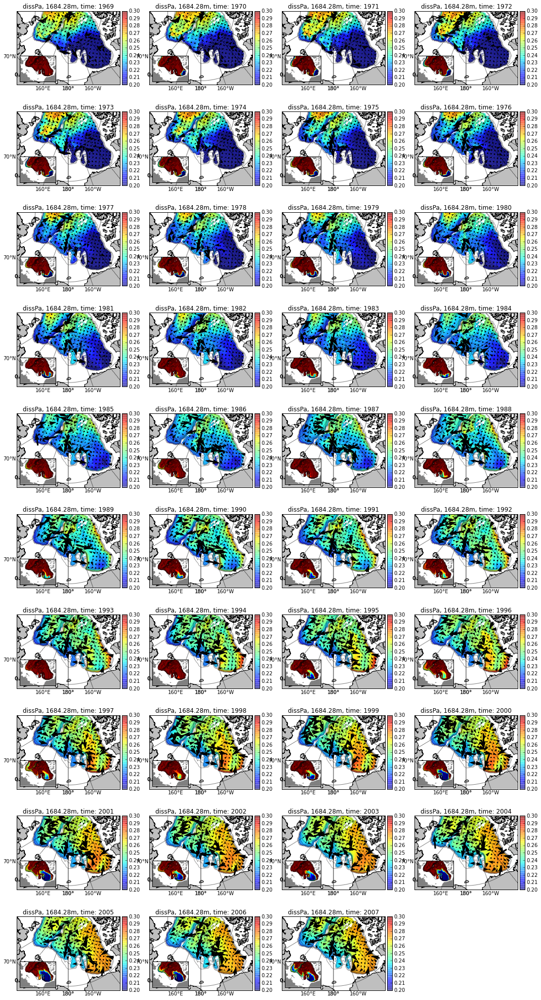

In [202]:
# after rotation

layer=38
k=0

fig = plt.figure(figsize=(18,35))
for i in range (0,yearnum,1):
    time =i
    data =ptrc.variables['TR_7'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)

    k+=1

    ax = fig.add_subplot(10,4,k)
    m = Basemap(width =3.5e6,height =2.5e6,lon_0=-180, lat_0=80,
            projection='stere', resolution='l')
    #m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0.2,vmax=0.3,alpha=0.3);m.colorbar()
    m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    #quiver
    U =vel('U',time)
    V =vel('V',time)
    #mask too large value
    u =np.ma.masked_where(abs(V)>0.03,U)
    v =np.ma.masked_where(abs(V)>0.03,V)
    u =np.ma.masked_where(abs(U)>0.03,u)
    v =np.ma.masked_where(abs(U)>0.03,v)
    # need this lines to fix the problem in u direction..
    uu = np.zeros((u.shape))
    u = u - uu

    
    u_rot, v_rot, x, y = m.rotate_vector(u[layer,::10,::10], v[layer,::10,::10], \
                                         lon[::10,::10], lat[::10,::10], returnxy=True)

    #Q=m.quiver(lon[::10,::10],lat[::10,::10], -u[layer,::10,::10], v[layer,::10,::10],
    #           scale=0.25,width=0.01,latlon=True)
    Q=m.quiver(x, y, u_rot, v_rot,
               scale=0.25,width=0.015,pivot='middle')
    Qlabel=plt.quiverkey(Q,0.1, 0.05, 0.02, '0.02 m/s',fontproperties={'weight': 'bold'}) #x(0-1),y(0-1), scale, label, position
    plt.title('dissPa, %sm, time: %s'%(dep[layer],1969+i))
    
    m.ax = ax
    # add inset

    axin = inset_axes(m.ax, width='35%', height='35%', loc=3)

    inmap = Basemap(width =3.5e6,height =2.5e6,lon_0=-180, lat_0=80,
            projection='stere', resolution='l')
    inmap.fillcontinents('grey')
    data =ptrc.variables['TR_11'][time,:,:,:]
    #analytical 
    Q = 0.00246
    k_de= 1.5
    s = -508*data+1616
    k_ad = -0.055*data+0.082
    data = Q/k_ad + k_de/k_ad*(Q/s*dep[layer]+0.004)
    #
    data =np.ma.masked_where(tmask==0,data)
    inmap.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0.2,vmax=0.3);
    inmap.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)

plt.show()

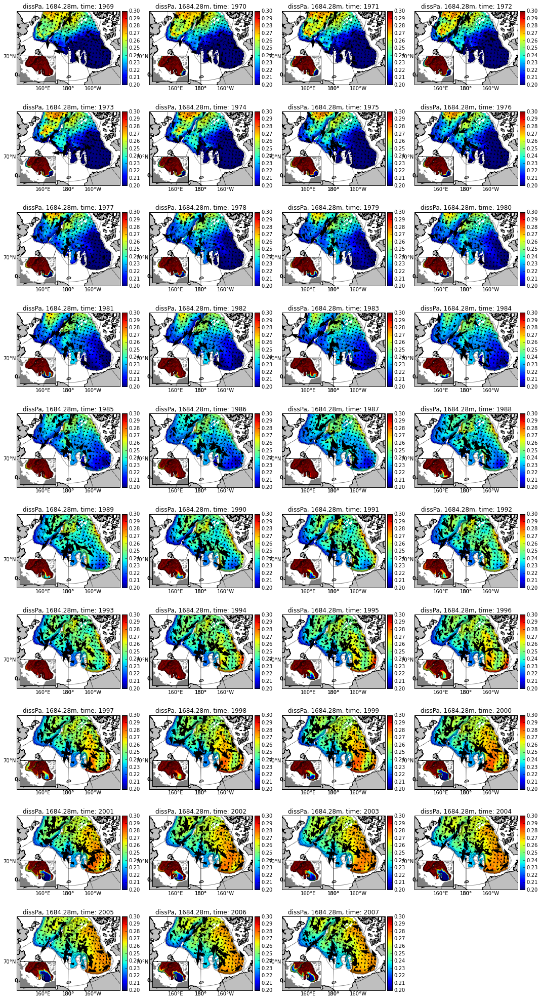

In [208]:
# before rotation

layer=38
k=0

fig = plt.figure(figsize=(18,35))
for i in range (0,yearnum,1):
    time =i
    data =ptrc.variables['TR_7'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)

    k+=1

    ax = fig.add_subplot(10,4,k)
    m = Basemap(width =3.5e6,height =2.5e6,lon_0=-180, lat_0=80,
            projection='stere', resolution='l')
    #m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0.2,vmax=0.3);m.colorbar()
    m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    #quiver
    U =vel('U',time)
    V =vel('V',time)
    #mask too large value
    u =np.ma.masked_where(abs(V)>0.03,U)
    v =np.ma.masked_where(abs(V)>0.03,V)
    u =np.ma.masked_where(abs(U)>0.03,u)
    v =np.ma.masked_where(abs(U)>0.03,v)
    
    Q=m.quiver(x_lon[::10,::10], y_lat[::10,::10], u[layer,::10,::10], v[layer,::10,::10],
               scale=0.25,width=0.015)
    Qlabel=plt.quiverkey(Q,0.1, 0.05, 0.02, '0.02 m/s',fontproperties={'weight': 'bold'}) #x(0-1),y(0-1), scale, label, position
    plt.title('dissPa, %sm, time: %s'%(dep[layer],1969+i))
    
    m.ax = ax
    # add inset

    axin = inset_axes(m.ax, width='35%', height='35%', loc=3)

    inmap = Basemap(width =3.5e6,height =2.5e6,lon_0=-180, lat_0=80,
            projection='stere', resolution='l')
    inmap.fillcontinents('grey')
    data =ptrc.variables['TR_11'][time,:,:,:]
    #analytical 
    Q = 0.00246
    k_de= 1.5
    s = -508*data+1616
    k_ad = -0.055*data+0.082
    data = Q/k_ad + k_de/k_ad*(Q/s*dep[layer]+0.004)
    #
    data =np.ma.masked_where(tmask==0,data)
    inmap.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0.2,vmax=0.3);
    inmap.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)

plt.show()

# ????
* It's much lower than the analytical solution.. 

# 1.2 diss pa (analy solution) - using the same cbar as above

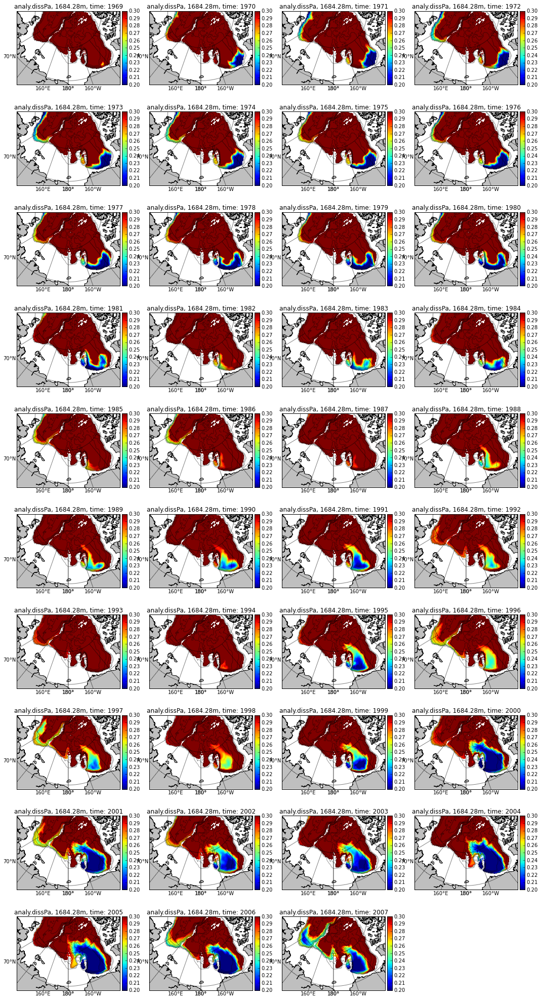

In [96]:
# plot analy. solution to understand the change above.

Q = 0.00246
k_de= 1.5


layer=38
k=0

fig = plt.figure(figsize=(18,35))
for i in range (0,yearnum,1):
    time =i
    data =ptrc.variables['TR_11'][time,:,:,:]
    s = -508*data+1616
    k_ad = -0.055*data+0.082
    data = Q/k_ad + k_de/k_ad*(Q/s*dep[layer]+0.004)
    data =np.ma.masked_where(tmask==0,data)

    k+=1

    ax = fig.add_subplot(10,4,k)
    #m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m = Basemap(width =3.5e6,height =2.5e6,lon_0=-180, lat_0=80,
            projection='stere', resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0.2,vmax=0.3);m.colorbar()
    m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.title('analy.dissPa, %sm, time: %s'%(dep[layer],1969+i))

plt.show()

# 1.3 diss Th (Model results)

The trend of ice signal should be the same as the trend of diss. tracer concentrations.. Unlike the particulate phase (section 2), the dissolved phase is not responding very quickly to the change of the ice signal.

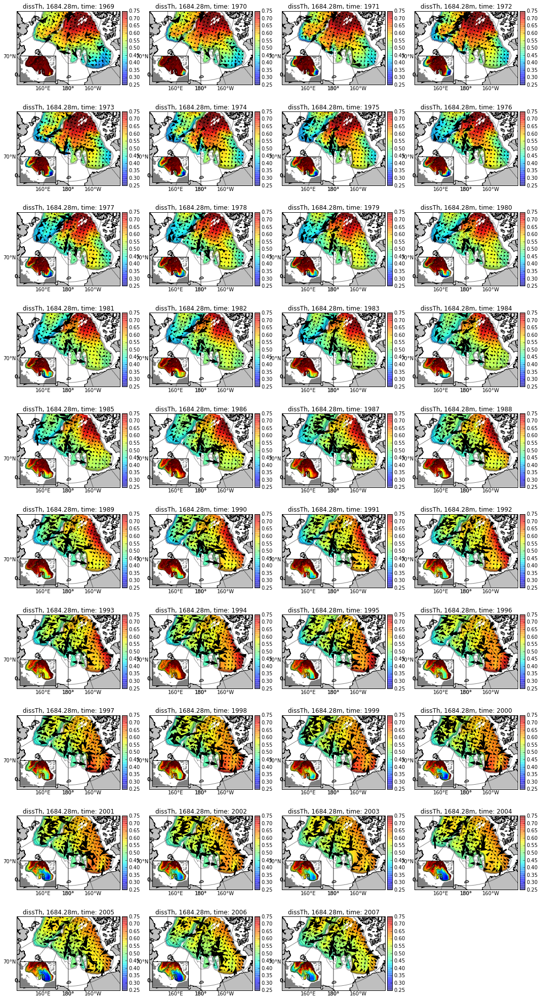

In [8]:
# after rotation

layer=38
k=0

fig = plt.figure(figsize=(18,35))
for i in range (0,yearnum,1):
    time =i
    data =ptrc.variables['TR_8'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)

    k+=1

    ax = fig.add_subplot(10,4,k)
    m = Basemap(width =3.5e6,height =2.5e6,lon_0=-180, lat_0=80,
            projection='stere', resolution='l')
    #m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0.25,vmax=0.75,alpha=0.3);m.colorbar()
    m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    #quiver
    U =vel('U',time)
    V =vel('V',time)
    #mask too large value
    u =np.ma.masked_where(abs(V)>0.03,U)
    v =np.ma.masked_where(abs(V)>0.03,V)
    u =np.ma.masked_where(abs(U)>0.03,u)
    v =np.ma.masked_where(abs(U)>0.03,v)
    # need this lines to fix the problem in u direction..
    uu = np.zeros((u.shape))
    u = u - uu

    
    u_rot, v_rot, x, y = m.rotate_vector(u[layer,::10,::10], v[layer,::10,::10], \
                                         lon[::10,::10], lat[::10,::10], returnxy=True)

    #Q=m.quiver(lon[::10,::10],lat[::10,::10], -u[layer,::10,::10], v[layer,::10,::10],
    #           scale=0.25,width=0.01,latlon=True)
    Q=m.quiver(x, y, u_rot, v_rot,
               scale=0.25,width=0.015,pivot='middle')
    Qlabel=plt.quiverkey(Q,0.1, 0.05, 0.02, '0.02 m/s',fontproperties={'weight': 'bold'}) #x(0-1),y(0-1), scale, label, position
    plt.title('dissTh, %sm, time: %s'%(dep[layer],1969+i))
    
    m.ax = ax
    # add inset

    axin = inset_axes(m.ax, width='35%', height='35%', loc=3)

    inmap = Basemap(width =3.5e6,height =2.5e6,lon_0=-180, lat_0=80,
            projection='stere', resolution='l')
    inmap.fillcontinents('grey')
    data =ptrc.variables['TR_12'][time,:,:,:]
    #analytical 
    Q = 0.0267
    k_de= 0.5
    s = -1115*data+1600
    k_ad = -0.12*data+0.2
    data = Q/k_ad + k_de/k_ad*(Q/s*dep[layer]+0.03)
    #
    data =np.ma.masked_where(tmask==0,data)
    inmap.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0.25,vmax=0.75);
    inmap.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)

plt.show()

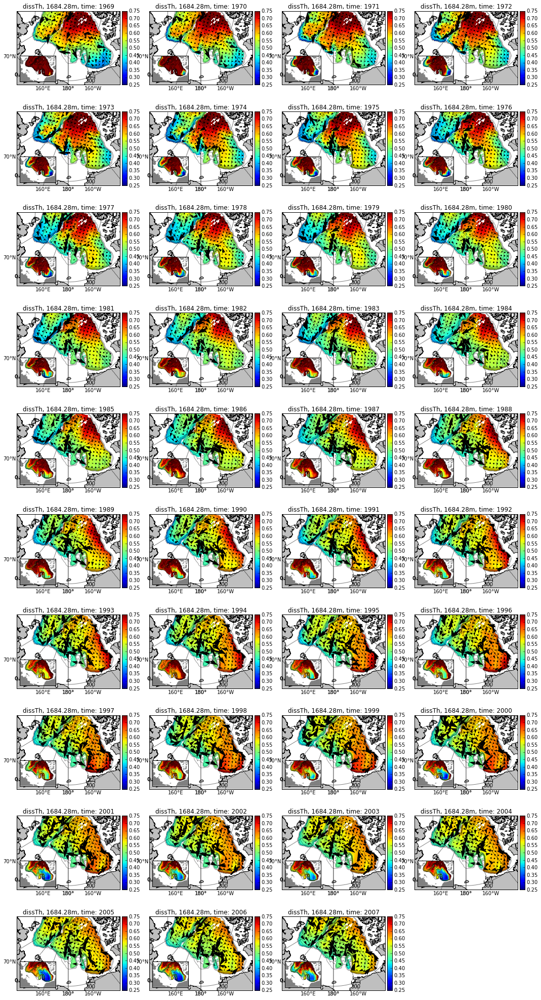

In [211]:
# before rotation

layer=38
k=0

fig = plt.figure(figsize=(18,35))
for i in range (0,yearnum,1):
    time =i
    data =ptrc.variables['TR_8'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)

    k+=1

    ax = fig.add_subplot(10,4,k)
    #m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m = Basemap(width =3.5e6,height =2.5e6,lon_0=-180, lat_0=80,
            projection='stere', resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0.25,vmax=0.75);m.colorbar()
    m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
        #quiver
    U =vel('U',time)
    V =vel('V',time)
    #mask too large value
    u =np.ma.masked_where(abs(V)>0.03,U)
    v =np.ma.masked_where(abs(V)>0.03,V)
    u =np.ma.masked_where(abs(U)>0.03,u)
    v =np.ma.masked_where(abs(U)>0.03,v)
    # need this lines to fix the problem in u direction..
    uu = np.zeros((u.shape))
    u = u - uu
    
    Q=m.quiver(x_lon[::10,::10], y_lat[::10,::10], u[layer,::10,::10], v[layer,::10,::10],
               scale=0.25,width=0.015,pivot='middle')
    Qlabel=plt.quiverkey(Q,0.1, 0.05, 0.02, '0.02 m/s',fontproperties={'weight': 'bold'}) #x(0-1),y(0-1), scale, label, position
    #draw scale bar
    m.drawmapscale(-160,70,-160,70,300,fontsize=10)
    plt.title('dissTh, %sm, time: %s'%(dep[layer],1969+i))
    
    m.ax = ax
    # add inset

    axin = inset_axes(m.ax, width='35%', height='35%', loc=3)

    inmap = Basemap(width =3.5e6,height =2.5e6,lon_0=-180, lat_0=80,
            projection='stere', resolution='l')
    inmap.fillcontinents('grey')
    data =ptrc.variables['TR_12'][time,:,:,:]
    #analy
    Q = 0.0267
    k_de= 0.5
    s = -1115*data+1600
    k_ad = -0.12*data+0.2
    data = Q/k_ad + k_de/k_ad*(Q/s*dep[layer]+0.03)
    #
    data =np.ma.masked_where(tmask==0,data)
    inmap.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0.25,vmax=0.75);
    inmap.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)

plt.show()

In [137]:
print 'tracers can travel about ',0.01*3600*24*365/1000,'km per year. (With ice signal, 600km per year.)' 

tracers can travel about  315.36 km per year. (With ice signal, 600km per year.)


# ????  
* What happened in 1990s? why the high concentration on Alpha Ridge disappear?... 

# 1.3  diss Th (analytical solutions)

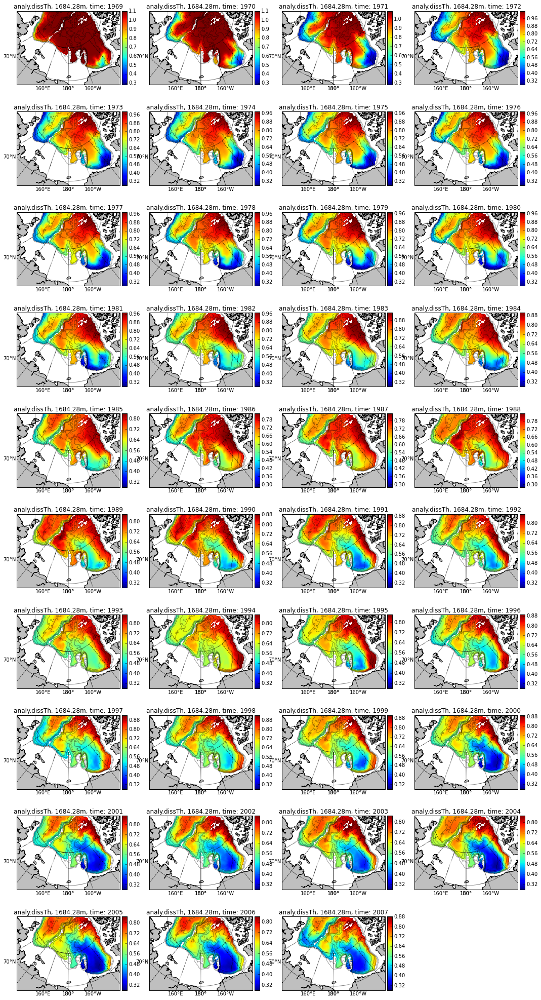

In [18]:
# plot analy. solution to understand the change above.

Q = 0.0267
k_de= 0.5


layer=38
k=0

fig = plt.figure(figsize=(18,35))
for i in range (0,yearnum,1):
    time =i
    data =ptrc.variables['TR_12'][time,:,:,:]
    s = -1115*data+1600
    k_ad = -0.12*data+0.2
    data = Q/k_ad + k_de/k_ad*(Q/s*dep[layer]+0.03)
    data =np.ma.masked_where(tmask==0,data)

    k+=1

    ax = fig.add_subplot(10,4,k)
    #m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m = Basemap(width =3.5e6,height =2.5e6,lon_0=-180, lat_0=80,
            projection='stere', resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[layer,:,:]);m.colorbar()
    m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.title('analy.dissTh, %sm, time: %s'%(dep[layer],1969+i))

plt.show()

# Exploring analytical solutions from ice signal without advection.

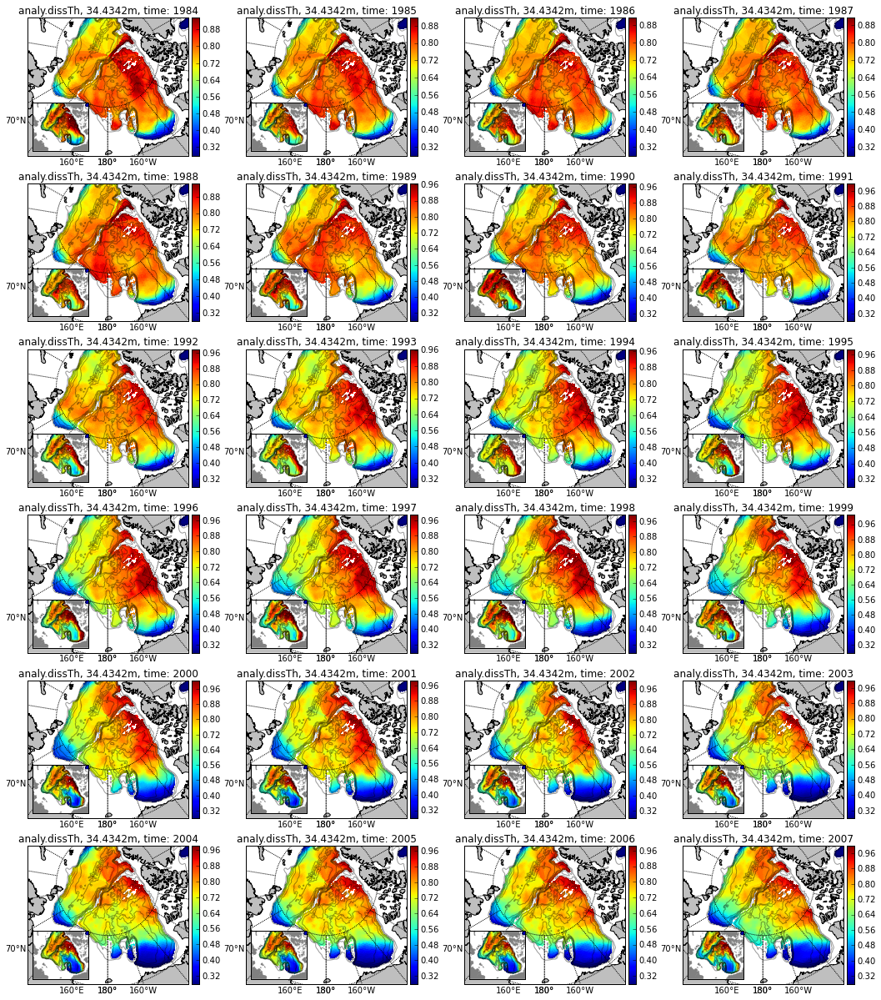

In [19]:
# plot analy. solution to understand the change above.

Q = 0.0267
k_de= 0.5


layer=15
k=0

fig = plt.figure(figsize=(18,35))
for i in range (15,yearnum,1):
    time =i
    data =ptrc.variables['TR_12'][time-5:time+1,layer,:,:]
    data = data.mean(axis=0)  
    s = -1115*data+1600
    k_ad = -0.12*data+0.2
    data = Q/k_ad + k_de/k_ad*(Q/s*dep[38]+0.03)
    data =np.ma.masked_where(tmask[38,:,:]==0,data)

    k+=1

    ax = fig.add_subplot(10,4,k)
    #m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m = Basemap(width =3.5e6,height =3e6,lon_0=-180, lat_0=84,
            projection='stere', resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[:,:]);m.colorbar()
    m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.title('analy.dissTh, %sm, time: %s'%(dep[layer],1969+i))
    
    m.ax = ax
    # add inset

    axin = inset_axes(m.ax, width='35%', height='35%', loc=3)

    inmap = Basemap(width =3.5e6,height =3e6,lon_0=-180, lat_0=84,
            projection='stere', resolution='l')
    inmap.fillcontinents('grey')
    data =ptrc.variables['TR_12'][time,38,:,:]
    #analy
    Q = 0.0267
    k_de= 0.5
    s = -1115*data+1600
    k_ad = -0.12*data+0.2
    data = Q/k_ad + k_de/k_ad*(Q/s*dep[38]+0.03)
    #
    data =np.ma.masked_where(tmask[38,:,:]==0,data)
    inmap.pcolor(x_lon,y_lat,data[:,:],vmin=0.24,vmax=0.88);
    inmap.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)

plt.show()

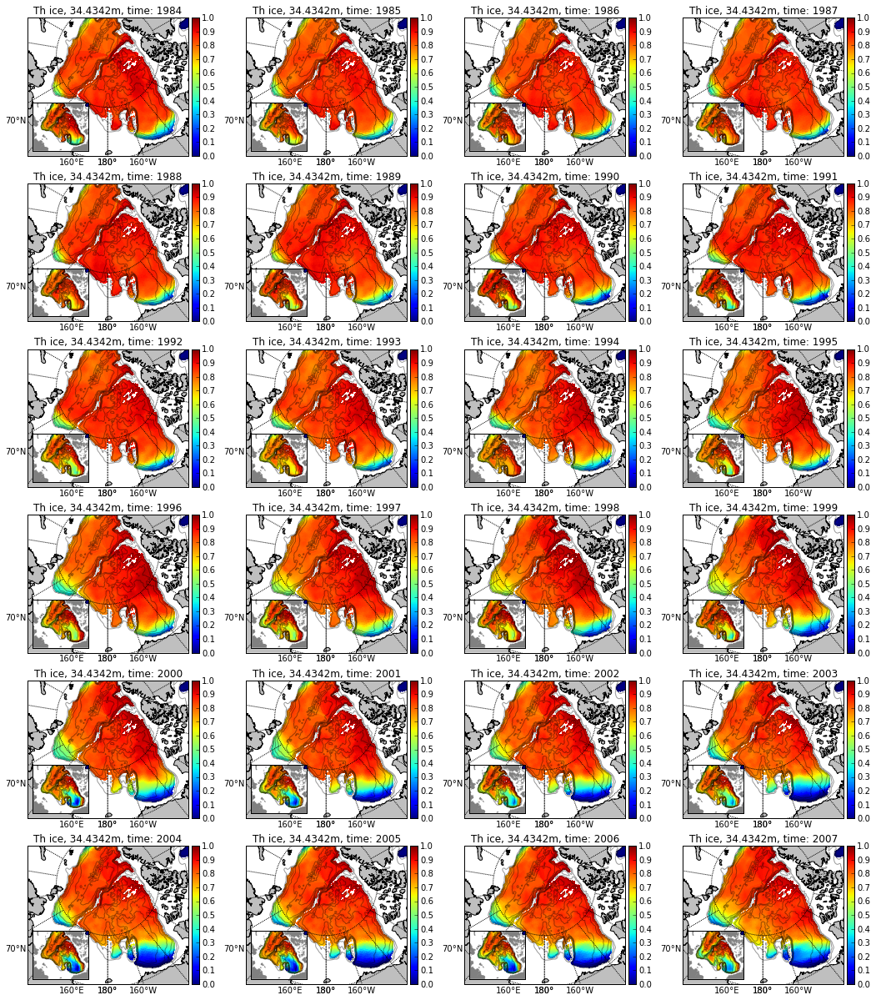

In [9]:
# plot ice to understand the change above.

Q = 0.0267
k_de= 0.5


layer=15
k=0

fig = plt.figure(figsize=(18,35))
for i in range (15,yearnum,1):
    time =i
    data =ptrc.variables['TR_12'][time-5:time+1,layer,:,:]
    data = data.mean(axis=0)  
    data =np.ma.masked_where(tmask[38,:,:]==0,data)

    k+=1

    ax = fig.add_subplot(10,4,k)
    #m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m = Basemap(width =3.5e6,height =3e6,lon_0=-180, lat_0=84,
            projection='stere', resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[:,:],vmin=0,vmax=1);m.colorbar()
    m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.title('Th ice, %sm, time: %s'%(dep[layer],1969+i))
    
    m.ax = ax
    # add inset

    axin = inset_axes(m.ax, width='35%', height='35%', loc=3)

    inmap = Basemap(width =3.5e6,height =3e6,lon_0=-180, lat_0=84,
            projection='stere', resolution='l')
    inmap.fillcontinents('grey')
    data =ptrc.variables['TR_12'][time,38,:,:]

    data =np.ma.masked_where(tmask[38,:,:]==0,data)
    inmap.pcolor(x_lon,y_lat,data[:,:],vmin=0,vmax=1);
    inmap.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)

plt.show()

# 1.4 Pa/Th

/home/xiaoxiny/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:9: RuntimeWarning: invalid value encountered in divide


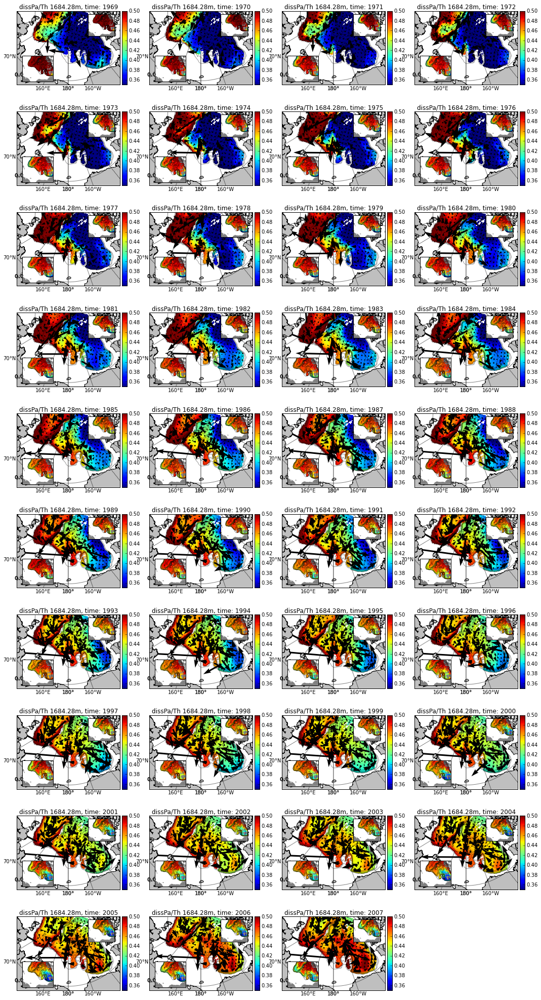

In [98]:
# Pa/Th

layer=38
k=0

fig = plt.figure(figsize=(18,35))
for i in range (0,yearnum,1):
    time =i
    data =ptrc.variables['TR_7'][time,:,:,:]/ptrc.variables['TR_8'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)
    data[:,:120,:] =np.ma.masked

    k+=1

    ax = fig.add_subplot(10,4,k)
    #m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m = Basemap(width =3.5e6,height =2.5e6,lon_0=-180, lat_0=80,
            projection='stere', resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0.35,vmax=0.50);m.colorbar()
    m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    #quiver
    u =vel('U',time)
    v =vel('V',time)
    #mask too large value
    u =np.ma.masked_where(abs(v)>0.03,u)
    v =np.ma.masked_where(abs(v)>0.03,v)
    
    Q=m.quiver(x_lon[::10,::10], y_lat[::10,::10], u[layer,::10,::10], v[layer,::10,::10],
               scale=0.175,width=0.015)
    Qlabel=plt.quiverkey(Q,0.1, 0.05, 0.02, '0.02 m/s',fontproperties={'weight': 'bold'}) #x(0-1),y(0-1), scale, label, position
    plt.title('dissPa/Th %sm, time: %s'%(dep[layer],1969+i))
    
    m.ax = ax
    # add inset

    axin = inset_axes(m.ax, width='35%', height='35%', loc=3)

    inmap = Basemap(width =3e6,height =2.5e6,lon_0=-160, lat_0=80,
            projection='stere', resolution='l')
    inmap.fillcontinents('grey')
    data =ptrc.variables['TR_11'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)
    inmap.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0,vmax=1);
    inmap.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
                  
    
    # add inset
    axin_right = inset_axes(m.ax, width='30%', height='30%', loc=1)

    inmap = Basemap(width =3e6,height =2.5e6,lon_0=-160, lat_0=80,
            projection='stere', resolution='l')
    inmap.fillcontinents('grey')
    data =ptrc.variables['TR_12'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)
    inmap.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0,vmax=1);
    inmap.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)


plt.show()

# ????
What is going on in 2005-2007? Why is the red colour spread all over the CB?

# 2.particulate phase

(39,)
0
1
2
0
1
2


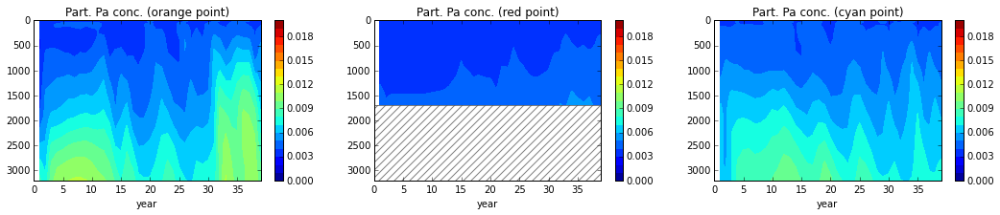

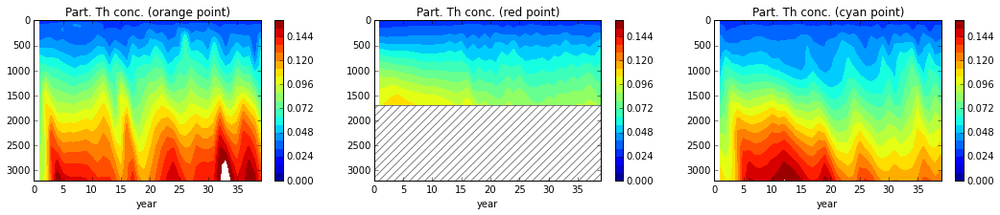

In [204]:
x=np.array([700-400,590-400,560-400])#/2
y=np.array([180,264,340])#/2
c=['orange','red','cyan']

time=np.empty(yearnum)
print time.shape
for i in range (len(time)):
    time[i]=i+1

fig = plt.figure(figsize=(18,3))
for i in range (len(y)):
    print i
    ax = fig.add_subplot(1,3,i+1)
    data=ptrc.variables['TR_9'][:,10:,x[i],y[i]]
    data=np.ma.masked_where(data<=0,data)
    ax.add_patch(patches.Rectangle((0, dep[mbathy[x[i],y[i]]-1]), len(time),3000,hatch='///',
                                   fill=False,alpha=0.5))
    
    plt.contourf(time[:],dep[10:],data.T,np.linspace(0, 0.02, 21))
    plt.colorbar()
    plt.title('Part. Pa conc. (%s point)'%c[i])
    plt.ylim(0,3200)
    plt.xlim(1,len(time))
    plt.xlabel('year')
    ax.invert_yaxis()
    plt.xticks(np.arange(0, len(time)+1, 5))

 
    
fig = plt.figure(figsize=(18,3))
for i in range (len(y)):
    print i
    ax = fig.add_subplot(1,3,i+1)
    data=ptrc.variables['TR_10'][:,10:,x[i],y[i]]
    data=np.ma.masked_where(data<=0,data)
    ax.add_patch(patches.Rectangle((0, dep[mbathy[x[i],y[i]]-1]), len(time),3000,hatch='///',
                                   fill=False,alpha=0.5))
    
    plt.contourf(time[:],dep[10:],data.T,np.linspace(0,0.16, 21))
    plt.colorbar()
    plt.title('Part. Th conc. (%s point)'%c[i])
    plt.ylim(0,3200)
    plt.xlabel('year')
    ax.invert_yaxis() 
    plt.xticks(np.arange(0, len(time)+1, 5))

plt.show()

# part Pa

The ice signal affects the particulate phase field faster than the dissolved field.

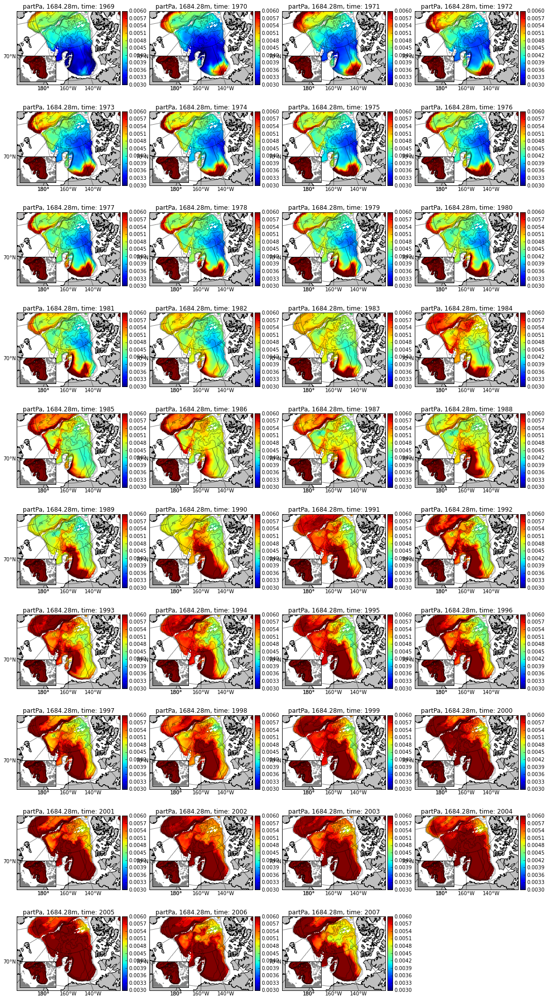

In [13]:
layer=38
k=0

fig = plt.figure(figsize=(18,35))
for i in range (0,yearnum,1):
    time =i
    data =ptrc.variables['TR_9'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)

    k+=1

    ax = fig.add_subplot(10,4,k)
    m = Basemap(width =3.5e6,height =2.5e6,lon_0=-180, lat_0=80,
            projection='stere', resolution='l')
    #m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0.003,vmax=0.006);m.colorbar()
    m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.title('partPa, %sm, time: %s'%(dep[layer],1969+i))
    
    m.ax = ax
    # add inset

    axin = inset_axes(m.ax, width='35%', height='35%', loc=3)

    inmap = Basemap(width =3.5e6,height =2.5e6,lon_0=-180, lat_0=80,
            projection='stere', resolution='l')
    inmap.fillcontinents('grey')
    data =ptrc.variables['TR_11'][time,:,:,:]
    #analy
    Q = 0.00246
    k_de= 1.5
    s = -508*data+1616
    k_ad = -0.055*data+0.082
    data = (Q/s*dep[layer]+0.004)
    #
    data =np.ma.masked_where(tmask==0,data)
    inmap.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0.003,vmax=0.006);
    inmap.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)

plt.show()

Sum: http://nbviewer.jupyter.org/urls/bitbucket.org/ccar-modeling/analysis/raw/tip/Cindy%20Yu/ANHA4-result/Change_bahty_fse3t_based/Horizontal+Time-2002x6.ipynb

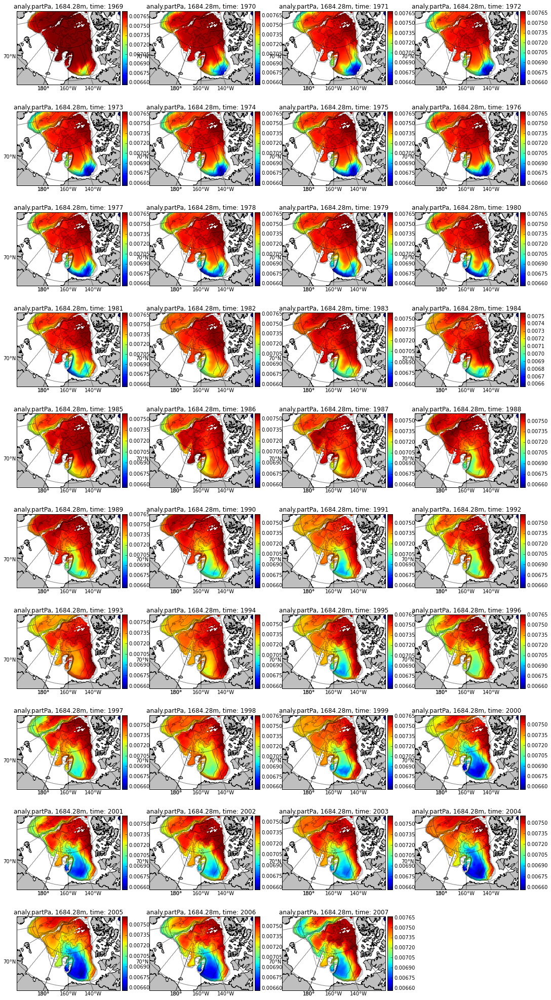

In [7]:
# plot analy. solution to understand the change above.

Q = 0.00246
k_de= 1.5


layer=38
k=0

fig = plt.figure(figsize=(18,35))
for i in range (0,yearnum,1):
    time =i
    data =ptrc.variables['TR_11'][time,:,:,:]
    s = -508*data+1616
    k_ad = -0.055*data+0.082
    data = (Q/s*dep[layer]+0.004)
    data =np.ma.masked_where(tmask==0,data)

    k+=1

    ax = fig.add_subplot(10,4,k)
    #m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m = Basemap(width =3.5e6,height =2.5e6,lon_0=-180, lat_0=80,
            projection='stere', resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[layer,:,:]);m.colorbar()
    m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.title('analy.partPa, %sm, time: %s'%(dep[layer],1969+i))

plt.show()

# part Th

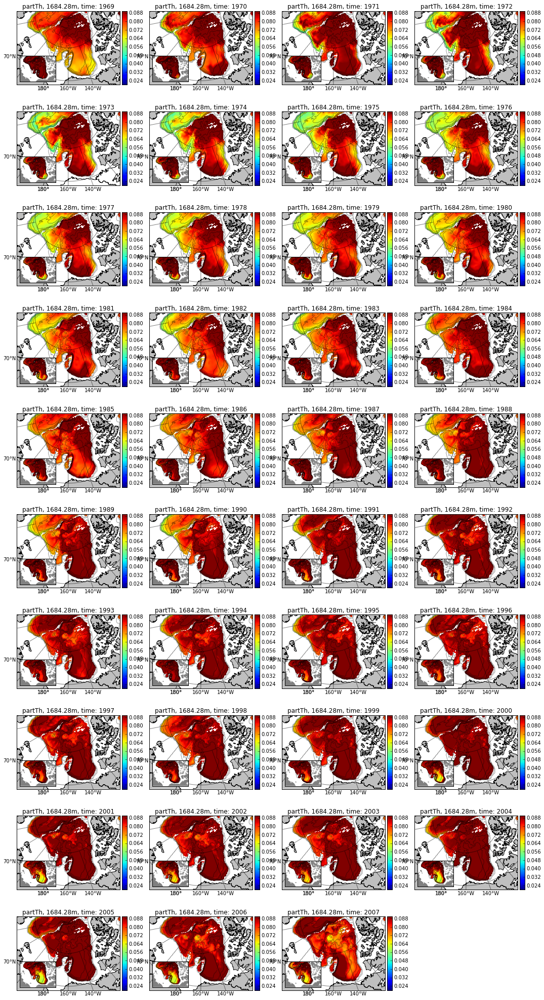

In [6]:
layer=38
k=0

fig = plt.figure(figsize=(18,35))
for i in range (0,yearnum,1):
    time =i
    data =ptrc.variables['TR_10'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)

    k+=1

    ax = fig.add_subplot(10,4,k)
    m = Basemap(width =3.5e6,height =2.5e6,lon_0=-180, lat_0=80,
            projection='stere', resolution='l')
    #m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0.02,vmax=0.09);m.colorbar()
    m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.title('partTh, %sm, time: %s'%(dep[layer],1969+i))
    
    m.ax = ax
    # add inset

    axin = inset_axes(m.ax, width='35%', height='35%', loc=3)

    inmap = Basemap(width =3.5e6,height =2.5e6,lon_0=-180, lat_0=80,
            projection='stere', resolution='l')
    inmap.fillcontinents('grey')
    data =ptrc.variables['TR_12'][time,:,:,:]
    #analy
    Q = 0.0267
    k_de= 0.5
    s = -1115*data+1600
    k_ad = -0.12*data+0.2
    data = Q/s*dep[layer]+0.03
    #
    data =np.ma.masked_where(tmask==0,data)
    inmap.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0.02,vmax=0.09);
    inmap.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)

plt.show()

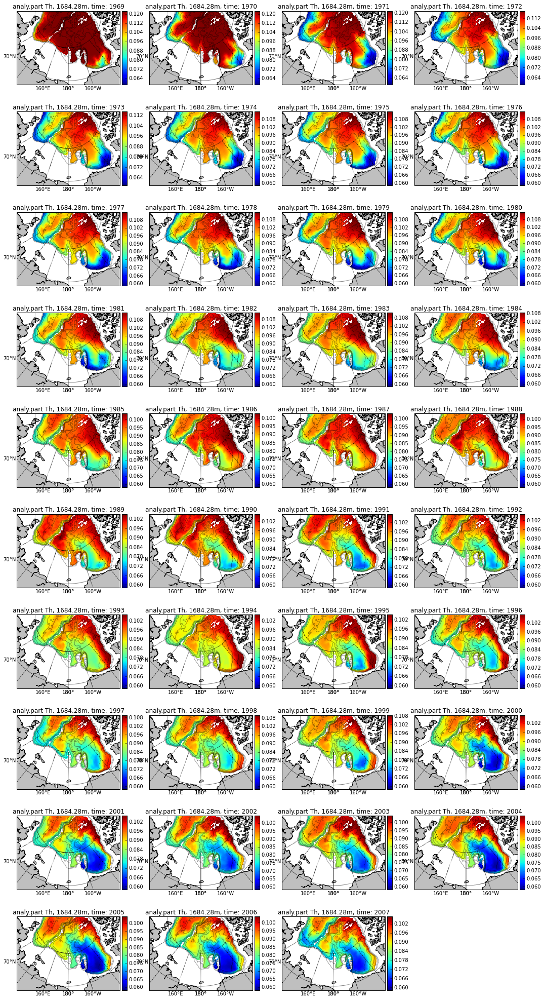

In [99]:
# plot analy. solution to understand the change above.

Q = 0.0267
k_de= 0.5


layer=38
k=0

fig = plt.figure(figsize=(18,35))
for i in range (0,yearnum,1):
    time =i
    data =ptrc.variables['TR_12'][time,:,:,:]
    s = -1115*data+1600
    k_ad = -0.12*data+0.2
    data = Q/s*dep[layer]+0.03
    data =np.ma.masked_where(tmask==0,data)

    k+=1

    ax = fig.add_subplot(10,4,k)
    #m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m = Basemap(width =3.5e6,height =2.5e6,lon_0=-180, lat_0=80,
            projection='stere', resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[layer,:,:]);m.colorbar()
    m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.title('analy.part Th, %sm, time: %s'%(dep[layer],1969+i))

plt.show()

/home/xiaoxiny/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:9: RuntimeWarning: invalid value encountered in divide


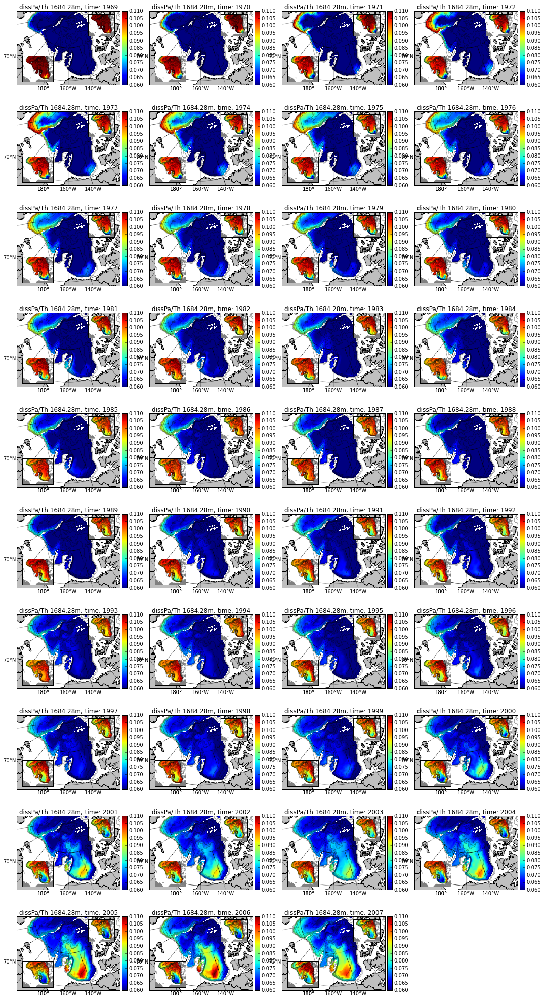

In [229]:
# Pa/Th

layer=38
k=0

fig = plt.figure(figsize=(18,35))
for i in range (0,yearnum,1):
    time =i
    data =ptrc.variables['TR_9'][time,:,:,:]/ptrc.variables['TR_10'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)
    data[:,:120,:] =np.ma.masked

    k+=1

    ax = fig.add_subplot(10,4,k)
    #m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m = Basemap(width =3.5e6,height =2.5e6,lon_0=-180, lat_0=80,
            projection='stere', resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0.06,vmax=0.11);m.colorbar()
    m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.title('dissPa/Th %sm, time: %s'%(dep[layer],1969+i))
    
    m.ax = ax
    # add inset

    axin = inset_axes(m.ax, width='35%', height='35%', loc=3)

    inmap = Basemap(width =3e6,height =2.5e6,lon_0=-160, lat_0=80,
            projection='stere', resolution='l')
    inmap.fillcontinents('grey')
    data =ptrc.variables['TR_11'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)
    inmap.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0,vmax=1);
    inmap.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
                  
    
    # add inset
    axin_right = inset_axes(m.ax, width='30%', height='30%', loc=1)

    inmap = Basemap(width =3e6,height =2.5e6,lon_0=-160, lat_0=80,
            projection='stere', resolution='l')
    inmap.fillcontinents('grey')
    data =ptrc.variables['TR_12'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)
    inmap.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0,vmax=1);
    inmap.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)


plt.show()

In [207]:
# ice conc. difference between initial field and final field.

(39,)


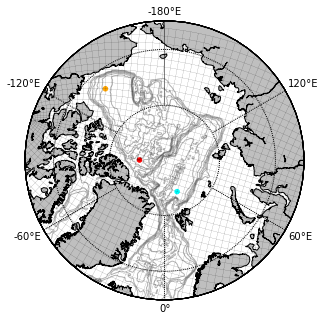

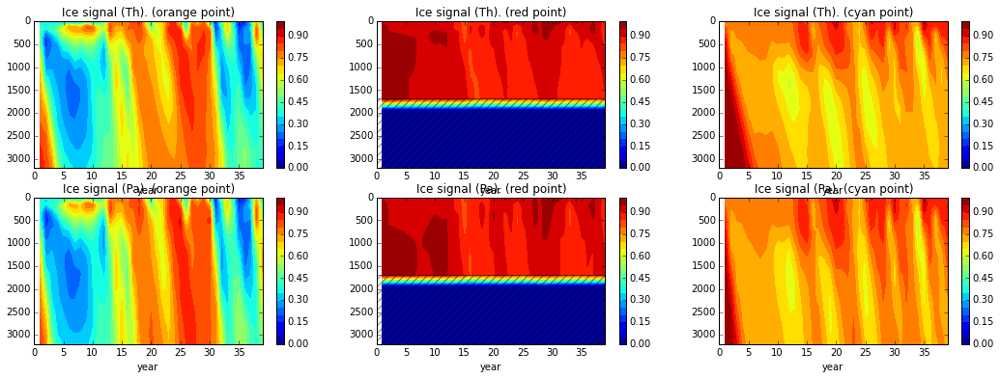

In [130]:
x=np.array([700-400,590-400,560-400])#/2
y=np.array([180,264,340])#/2
c=['orange','red','cyan']


time=np.empty(yearnum)
print time.shape
for i in range (len(time)):
    time[i]=i+1
    
    
fig = plt.figure(figsize=(5,10))
ax = fig.add_subplot()
m = Basemap(projection='npstere',boundinglat=65,lon_0=0,resolution='l',round='TRUE')
m.drawcoastlines()
m.fillcontinents(color = '0.75')
m.drawparallels(np.arange(-80.,80.,10.),labels=[1, 0, 0, 0])
m.drawmeridians(np.arange(-180.,180.,60.),labels=[0, 0, 1, 1])
x_lon,y_lat = m(lon,lat)
m.plot(x_lon[::10,::10],y_lat[::10,::10],x_lon.T[::10,::10],y_lat.T[::10,::10],color='k',linewidth=0.1)
m.scatter(x_lon[x,y],y_lat[x,y],color=c,s=20)
cs=m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.3)
#plt.clabel(cs, fontsize=10, inline=1,fmt = '%1.0f')


    
fig = plt.figure(figsize=(18,6))
for i in range (len(y)):
    ax = fig.add_subplot(2,3,i+1)
    
    data=ptrc.variables['TR_12'][:,10:,x[i],y[i]]
    data=np.ma.masked_where(data<=0,data)
    ax.add_patch(patches.Rectangle((0, dep[mbathy[x[i],y[i]]-1]), len(time),3000,hatch='///',
                                   fill=False,alpha=0.5))
    
    plt.contourf(time[:],dep[10:],ptrc.variables['TR_12'][:,10:,x[i],y[i]].T,np.linspace(0, 1, 21))
    plt.colorbar()
    plt.title('Ice signal (Th). (%s point)'%c[i])
    plt.ylim(0,3200)
    plt.xlim(1,len(time))
    plt.xlabel('year')
    ax.invert_yaxis()
    plt.xticks(np.arange(0, len(time)+1, 5))
    
    ax = fig.add_subplot(2,3,4+i)
    data=ptrc.variables['TR_11'][:,10:,x[i],y[i]]
    data=np.ma.masked_where(data<=0,data)
    ax.add_patch(patches.Rectangle((0, dep[mbathy[x[i],y[i]]-1]), len(time),3000,hatch='///',
                                   fill=False,alpha=0.5))
    
    plt.contourf(time[:],dep[10:],ptrc.variables['TR_11'][:,10:,x[i],y[i]].T,np.linspace(0, 1, 21))
    plt.colorbar()
    plt.title('Ice signal (Pa). (%s point)'%c[i])
    plt.ylim(0,3200)
    plt.xlim(1,len(time))
    plt.xlabel('year')
    ax.invert_yaxis()
    plt.xticks(np.arange(0, len(time)+1, 5))

 
plt.show()

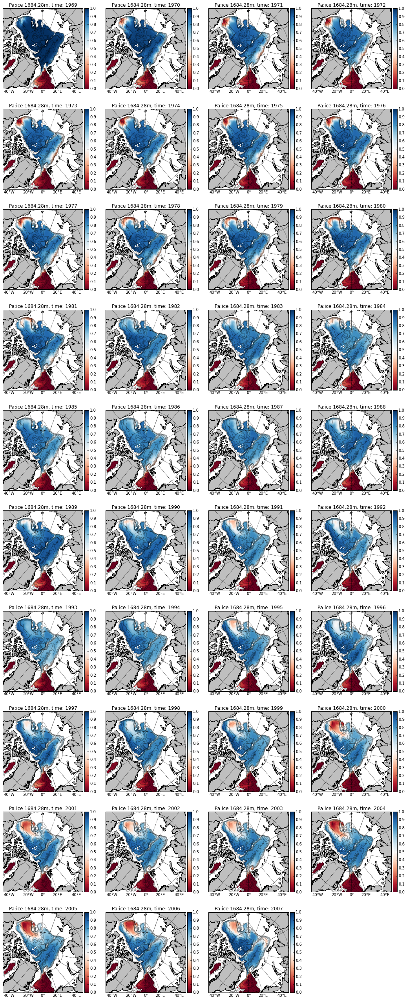

In [209]:
layer=38
k=0

fig = plt.figure(figsize=(18,45))
for i in range (0,yearnum,1):
    time =i
    data =ptrc.variables['TR_11'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)

    k+=1

    ax = fig.add_subplot(10,4,k)
    m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[layer,:,:],vmax=1,vmin=0,cmap='RdBu');m.colorbar()
    m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.title('Pa:ice %sm, time: %s'%(dep[layer],1969+i))

plt.show()

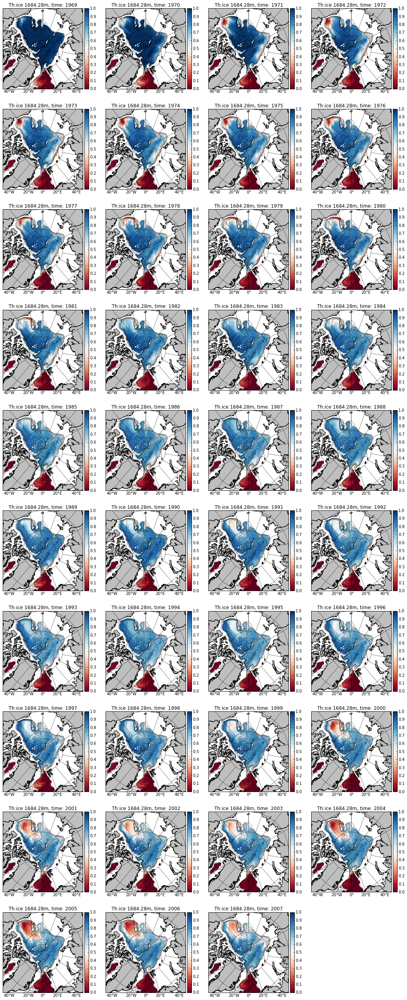

In [210]:
layer=38
k=0

fig = plt.figure(figsize=(18,45))
for i in range (0,yearnum,1):
    time =i
    data =ptrc.variables['TR_12'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)

    k+=1

    ax = fig.add_subplot(10,4,k)
    m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[layer,:,:],vmax=1,vmin=0,cmap='RdBu');m.colorbar()
    m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.title('Th:ice %sm, time: %s'%(dep[layer],1969+i))

plt.show()

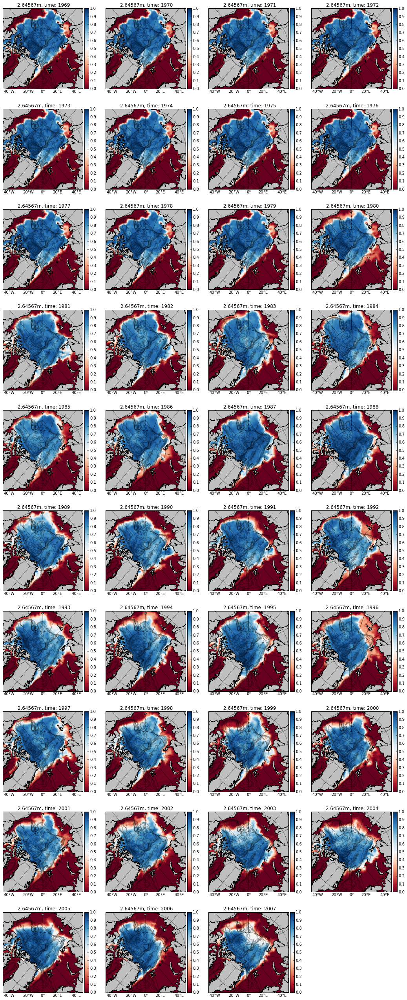

In [211]:
layer=2
k=0

fig = plt.figure(figsize=(18,45))
for i in range (0,yearnum,1):
    time =i
    data =ptrc.variables['TR_12'][time,:,:,:]#-TR_7[time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)

    k+=1

    ax = fig.add_subplot(10,4,k)
    m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0,vmax=1,cmap='RdBu');m.colorbar()
    m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.title(' %sm, time: %s'%(dep[layer],1969+i))

plt.show()